In [1]:
# Run any of the install.packages() commands below for packages you don't have.
#  install.packages("tmap")
#  install.packages("leaflet")
#  install.packages("leaflet.extras")
#  install.packages("scales")
#  install.packages("htmlwidgets")
#  install.packages("sf")
#  install.packages("dplyr")
library(raster)
library(rgdal)
library(RColorBrewer)
library(dplyr)
library("tmap")
library("scales")
library("leaflet")
library("sf")
library("leaflet.extras") #Needed for interactive map

options(stringsAsFactors = FALSE)

Loading required package: sp

Please note that rgdal will be retired during 2023,
plan transition to sf/stars/terra functions using GDAL and PROJ
at your earliest convenience.
See https://r-spatial.org/r/2022/04/12/evolution.html and https://github.com/r-spatial/evolution
rgdal: version: 1.6-4, (SVN revision 1196)
Geospatial Data Abstraction Library extensions to R successfully loaded
Loaded GDAL runtime: GDAL 3.5.2, released 2022/09/02
Path to GDAL shared files: D:/R/R-4.2.2/library/rgdal/gdal
GDAL binary built with GEOS: TRUE 
Loaded PROJ runtime: Rel. 8.2.1, January 1st, 2022, [PJ_VERSION: 821]
Path to PROJ shared files: D:/R/R-4.2.2/library/rgdal/proj
PROJ CDN enabled: FALSE
Linking to sp version:1.6-0
To mute warnings of possible GDAL/OSR exportToProj4() degradation,
use options("rgdal_show_exportToProj4_warnings"="none") before loading sp or rgdal.


Attaching package: 'dplyr'


The following objects are masked from 'package:raster':

    intersect, select, union


The following 

In [2]:
# Step 1: Get and correct the shape files

IRshapefile <- "C:/Users/thehd/OneDrive/College/YEAR_4/Visualizing_Data/Labwork/VisDataLab6/Maps/IRL_adm"
ogrListLayers(dsn=IRshapefile)

Warning message:
"OGR support is provided by the sf and terra packages among others"


[1] "IRL_adm0" "IRL_adm1"
attr(,"driver")
[1] "ESRI Shapefile"
attr(,"nlayers")
[1] 2

Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"


OGR data source with driver: ESRI Shapefile 
Source: "C:\Users\thehd\OneDrive\College\YEAR_4\Visualizing_Data\Labwork\VisDataLab6\Maps\IRL_adm", layer: "IRL_adm0"
with 1 features
It has 70 fields
Integer64 fields read as strings:  ID_0 OBJECTID_1 


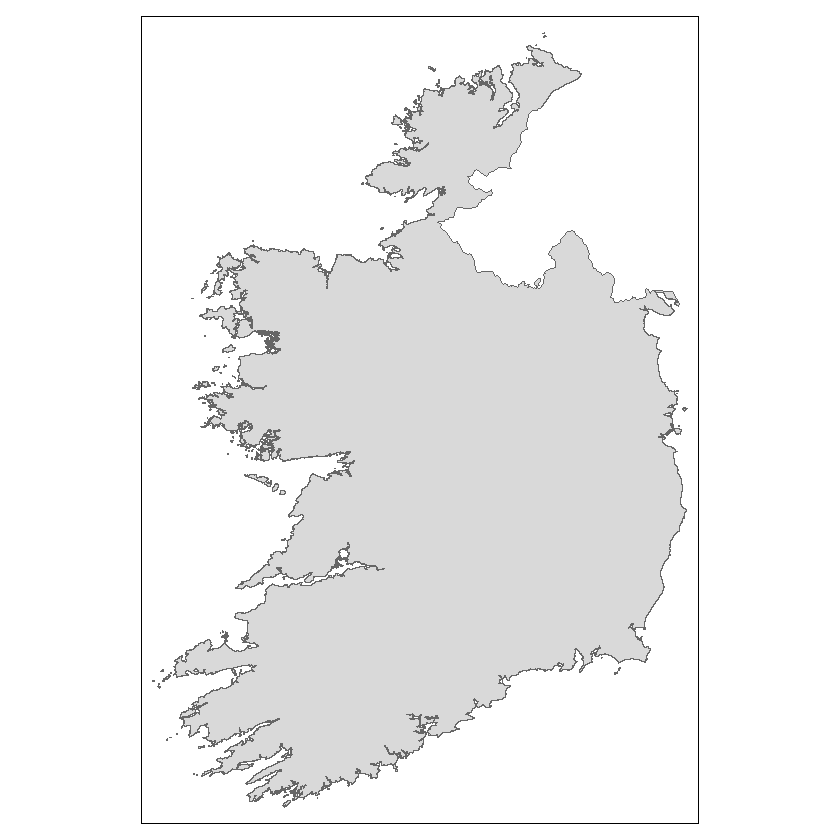

In [3]:
# Layer 1

IRgeo0 <- readOGR(IRshapefile, layer = "IRL_adm0")
qtm(IRgeo0)

Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"
Warning message:
"OGR support is provided by the sf and terra packages among others"


OGR data source with driver: ESRI Shapefile 
Source: "C:\Users\thehd\OneDrive\College\YEAR_4\Visualizing_Data\Labwork\VisDataLab6\Maps\IRL_adm", layer: "IRL_adm1"
with 26 features
It has 9 fields
Integer64 fields read as strings:  ID_0 ID_1 


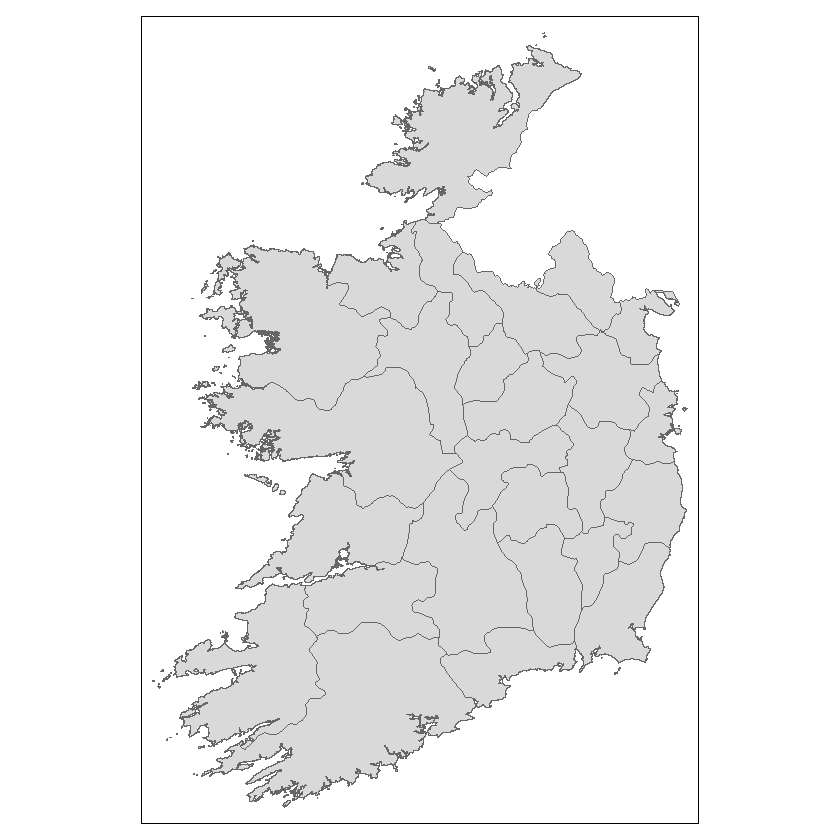

In [4]:
# Layer 2
IRgeo <- readOGR(IRshapefile, layer = "IRL_adm1")
qtm(IRgeo)

In [5]:
str(IRgeo)

Formal class 'SpatialPolygonsDataFrame' [package "sp"] with 5 slots
  ..@ data       :'data.frame':	26 obs. of  9 variables:
  .. ..$ ID_0     : chr [1:26] "109" "109" "109" "109" ...
  .. ..$ ISO      : chr [1:26] "IRL" "IRL" "IRL" "IRL" ...
  .. ..$ NAME_0   : chr [1:26] "Ireland" "Ireland" "Ireland" "Ireland" ...
  .. ..$ ID_1     : chr [1:26] "1" "2" "3" "4" ...
  .. ..$ NAME_1   : chr [1:26] "Carlow" "Cavan" "Clare" "Cork" ...
  .. ..$ TYPE_1   : chr [1:26] "Administrative County" "Administrative County" "Administrative County" "Traditional County" ...
  .. ..$ ENGTYPE_1: chr [1:26] "County" "County" "County" "County" ...
  .. ..$ NL_NAME_1: chr [1:26] NA NA NA NA ...
  .. ..$ VARNAME_1: chr [1:26] "Ceatharlach" "An Cabhán" "An Clár" "Corcaigh" ...
  ..@ polygons   :List of 26
  .. ..$ :Formal class 'Polygons' [package "sp"] with 5 slots
  .. .. .. ..@ Polygons :List of 1
  .. .. .. .. ..$ :Formal class 'Polygon' [package "sp"] with 5 slots
  .. .. .. .. .. .. ..@ labpt  : num [1:

In [6]:
# Rename county column
names(IRgeo)[names(IRgeo)  == "NAME_1"] <- "County"
str(IRgeo)

Formal class 'SpatialPolygonsDataFrame' [package "sp"] with 5 slots
  ..@ data       :'data.frame':	26 obs. of  9 variables:
  .. ..$ ID_0     : chr [1:26] "109" "109" "109" "109" ...
  .. ..$ ISO      : chr [1:26] "IRL" "IRL" "IRL" "IRL" ...
  .. ..$ NAME_0   : chr [1:26] "Ireland" "Ireland" "Ireland" "Ireland" ...
  .. ..$ ID_1     : chr [1:26] "1" "2" "3" "4" ...
  .. ..$ County   : chr [1:26] "Carlow" "Cavan" "Clare" "Cork" ...
  .. ..$ TYPE_1   : chr [1:26] "Administrative County" "Administrative County" "Administrative County" "Traditional County" ...
  .. ..$ ENGTYPE_1: chr [1:26] "County" "County" "County" "County" ...
  .. ..$ NL_NAME_1: chr [1:26] NA NA NA NA ...
  .. ..$ VARNAME_1: chr [1:26] "Ceatharlach" "An Cabhán" "An Clár" "Corcaigh" ...
  ..@ polygons   :List of 26
  .. ..$ :Formal class 'Polygons' [package "sp"] with 5 slots
  .. .. .. ..@ Polygons :List of 1
  .. .. .. .. ..$ :Formal class 'Polygon' [package "sp"] with 5 slots
  .. .. .. .. .. .. ..@ labpt  : num [1:

In [7]:
# Step 2: Enhance the data
IRgeo@data$Province <- sapply(IRgeo@data$County, switch, 
                            
                            'Carlow' = 'Leinster',
                            'Cavan' = 'Ulster',
                            'Clare' = 'Munster',
                            'Cork' = 'Munster',
                            'Donegal' = 'Ulster',
                            'Dublin' = 'Leinster',
                            'Galway' = 'Connaught',
                            'Kerry' =  'Munster',
                            'Kildare' = 'Leinster',
                            'Kilkenny' = 'Leinster',
                            'Laoighis' = 'Leinster',
                            'Leitrim' = 'Connaught',
                            'Limerick' =  'Munster',
                            'Longford' = 'Leinster',
                            'Louth' = 'Leinster',
                            'Mayo' = 'Connaught',
                            'Meath' = 'Leinster',
                            'Monaghan' = 'Ulster',
                            'Offaly' = 'Leinster',
                            'Roscommon' = 'Connaught',
                            'Sligo' = 'Connaught',
                            'Tipperary' =  'Munster',
                            'Waterford' =  'Munster',
                            'Westmeath' = 'Leinster',
                            'Wexford' = 'Leinster',
                            'Wicklow' = 'Leinster')

str(IRgeo)

Formal class 'SpatialPolygonsDataFrame' [package "sp"] with 5 slots
  ..@ data       :'data.frame':	26 obs. of  10 variables:
  .. ..$ ID_0     : chr [1:26] "109" "109" "109" "109" ...
  .. ..$ ISO      : chr [1:26] "IRL" "IRL" "IRL" "IRL" ...
  .. ..$ NAME_0   : chr [1:26] "Ireland" "Ireland" "Ireland" "Ireland" ...
  .. ..$ ID_1     : chr [1:26] "1" "2" "3" "4" ...
  .. ..$ County   : chr [1:26] "Carlow" "Cavan" "Clare" "Cork" ...
  .. ..$ TYPE_1   : chr [1:26] "Administrative County" "Administrative County" "Administrative County" "Traditional County" ...
  .. ..$ ENGTYPE_1: chr [1:26] "County" "County" "County" "County" ...
  .. ..$ NL_NAME_1: chr [1:26] NA NA NA NA ...
  .. ..$ VARNAME_1: chr [1:26] "Ceatharlach" "An Cabhán" "An Clár" "Corcaigh" ...
  .. ..$ Province : chr [1:26] "Leinster" "Ulster" "Munster" "Munster" ...
  ..@ polygons   :List of 26
  .. ..$ :Formal class 'Polygons' [package "sp"] with 5 slots
  .. .. .. ..@ Polygons :List of 1
  .. .. .. .. ..$ :Formal class 'P

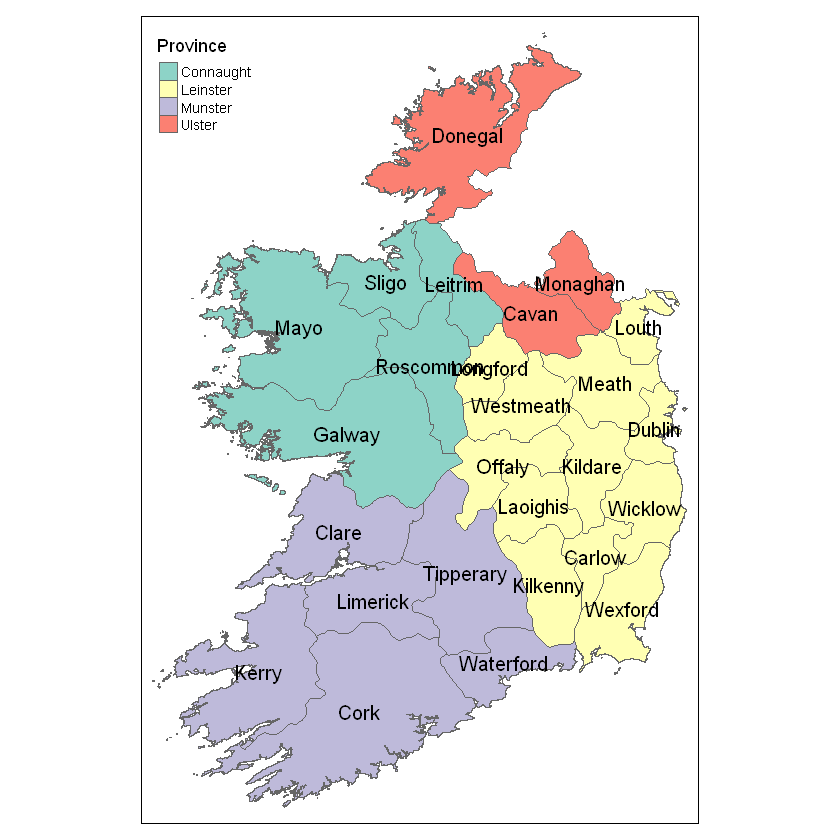

In [8]:
# Step 3: Generate a map
qtm(IRgeo, text = "County", fill = "Province")

In [9]:
# Step 4: Expand the data
popdata <- read.csv("C:/Users/thehd/OneDrive/College/YEAR_4/Visualizing_Data/Labwork/VisDataLab6/Data/IRCountyPop.csv")

In [10]:
str(popdata)
colnames(popdata)[1] = "County"

'data.frame':	32 obs. of  17 variables:
 $ county : chr  "Antrim" "Armagh" "Carlow" "Cavan" ...
 $ pop1841: int  361428 227190 81658 243094 285456 851528 222043 296448 366202 370745 ...
 $ pop1851: int  360498 189091 65222 173989 211865 647088 191765 255160 327617 402858 ...
 $ pop1861: int  372008 184138 54610 153870 165884 542486 184140 237390 306236 407068 ...
 $ pop1871: int  398624 171142 49012 140735 147779 515804 173906 218499 275922 405262 ...
 $ pop1881: int  413178 154515 44103 129476 141379 494312 164991 206166 246697 418910 ...
 $ pop1891: int  416143 135444 38734 111917 124425 437216 152009 185750 222973 419216 ...
 $ pop1901: int  543329 123018 35881 97451 110658 405517 144404 173772 209891 454990 ...
 $ pop1911: int  578704 117783 34498 91173 102604 392951 140625 168447 208566 492103 ...
 $ pop1926: int  608258 105693 33018 82452 93685 364906 141994 152508 207736 494484 ...
 $ pop1936: int  635692 102646 33127 76670 88642 355253 143693 142310 208578 586173 ...
 $ pop1951

In [11]:
IRgeo <- IRgeo[order(IRgeo$County),]
IRgeo$County

[1] "Carlow"    "Cavan"     "Clare"     "Cork"      "Donegal"   "Dublin"   
 [7] "Galway"    "Kerry"     "Kildare"   "Kilkenny"  "Laoighis"  "Leitrim"  
[13] "Limerick"  "Longford"  "Louth"     "Mayo"      "Meath"     "Monaghan" 
[19] "Offaly"    "Roscommon" "Sligo"     "Tipperary" "Waterford" "Westmeath"
[25] "Wexford"   "Wicklow"

In [12]:
popdata <- popdata[order(popdata$County),]
popdata$County

[1] "Antrim"    "Armagh"    "Carlow"    "Cavan"     "Clare"     "Cork"     
 [7] "Derry"     "Donegal"   "Down"      "Dublin"    "Fermanagh" "Galway"   
[13] "Kerry"     "Kildare"   "Kilkenny"  "Laois"     "Leitrim"   "Limerick" 
[19] "Longford"  "Louth"     "Mayo"      "Meath"     "Monaghan"  "Offaly"   
[25] "Roscommon" "Sligo"     "Tipperary" "Tyrone"    "Waterford" "Westmeath"
[31] "Wexford"   "Wicklow"

In [13]:
# Renaming Laoighis to Laois
IRgeo$County <- gsub("Laoighis", "Laois", IRgeo$County)
IRgeo$County

[1] "Carlow"    "Cavan"     "Clare"     "Cork"      "Donegal"   "Dublin"   
 [7] "Galway"    "Kerry"     "Kildare"   "Kilkenny"  "Laois"     "Leitrim"  
[13] "Limerick"  "Longford"  "Louth"     "Mayo"      "Meath"     "Monaghan" 
[19] "Offaly"    "Roscommon" "Sligo"     "Tipperary" "Waterford" "Westmeath"
[25] "Wexford"   "Wicklow"

In [14]:
# Dropping Northern Ireland counties
popdata <- popdata[-c(1, 2, 7, 9, 11, 28), ]

In [15]:
# merging popdata with IRgeo
IRmap <- merge(IRgeo, popdata, by.x="County")
str(IRmap)

Formal class 'SpatialPolygonsDataFrame' [package "sp"] with 5 slots
  ..@ data       :'data.frame':	26 obs. of  26 variables:
  .. ..$ County   : chr [1:26] "Carlow" "Cavan" "Clare" "Cork" ...
  .. ..$ ID_0     : chr [1:26] "109" "109" "109" "109" ...
  .. ..$ ISO      : chr [1:26] "IRL" "IRL" "IRL" "IRL" ...
  .. ..$ NAME_0   : chr [1:26] "Ireland" "Ireland" "Ireland" "Ireland" ...
  .. ..$ ID_1     : chr [1:26] "1" "2" "3" "4" ...
  .. ..$ TYPE_1   : chr [1:26] "Administrative County" "Administrative County" "Administrative County" "Traditional County" ...
  .. ..$ ENGTYPE_1: chr [1:26] "County" "County" "County" "County" ...
  .. ..$ NL_NAME_1: chr [1:26] NA NA NA NA ...
  .. ..$ VARNAME_1: chr [1:26] "Ceatharlach" "An Cabhán" "An Clár" "Corcaigh" ...
  .. ..$ Province : chr [1:26] "Leinster" "Ulster" "Munster" "Munster" ...
  .. ..$ pop1841  : int [1:26] 81658 243094 285456 851528 296448 370745 440210 293880 114228 200739 ...
  .. ..$ pop1851  : int [1:26] 65222 173989 211865 64708

Map saved to C:\Users\thehd\OneDrive\College\YEAR_4\Visualizing_Data\Labwork\VisDataLab6\IRmap0.jpg

Resolution: 1744.539 by 2527.888 pixels

Size: 5.81513 by 8.426294 inches (300 dpi)



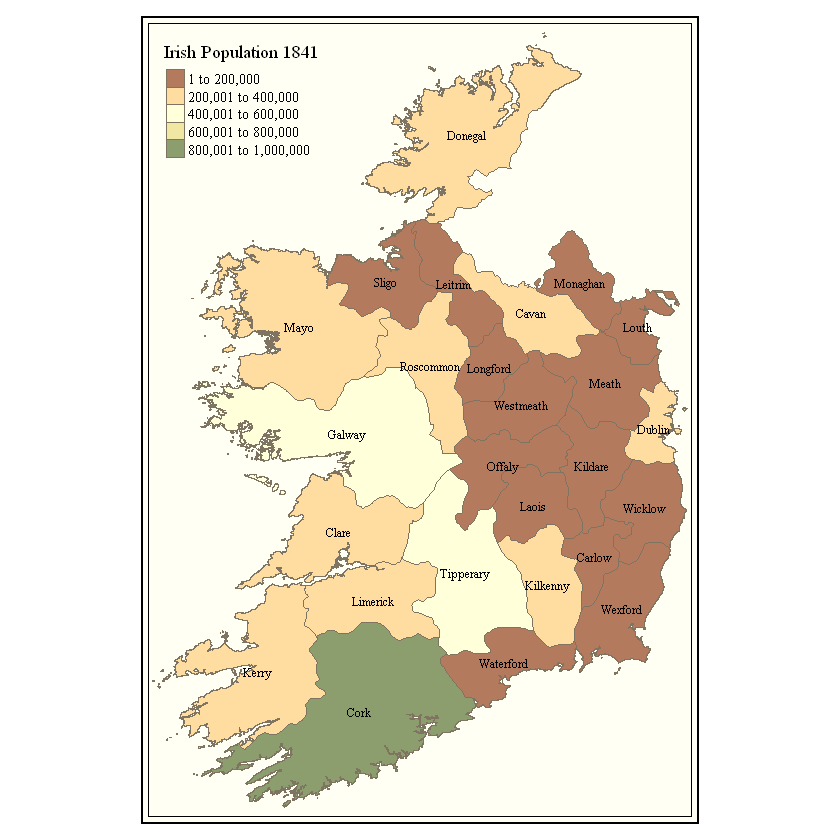

In [16]:
# Step 6: Creating static maps on merged data
IRmap0 <- tm_shape(IRmap) +
    tm_fill("pop1841", title = "Irish Population 1841", palette = "RdYlGn") +
    tm_borders(alpha = 1) +
    tm_text("County", size = 0.6) +
    tm_style("classic")
IRmap0
tmap_save(IRmap0, filename="IRmap0.jpg")

Map saved to C:\Users\thehd\OneDrive\College\YEAR_4\Visualizing_Data\Labwork\VisDataLab6\IRmap1.jpg

Resolution: 1744.539 by 2527.888 pixels

Size: 5.81513 by 8.426294 inches (300 dpi)



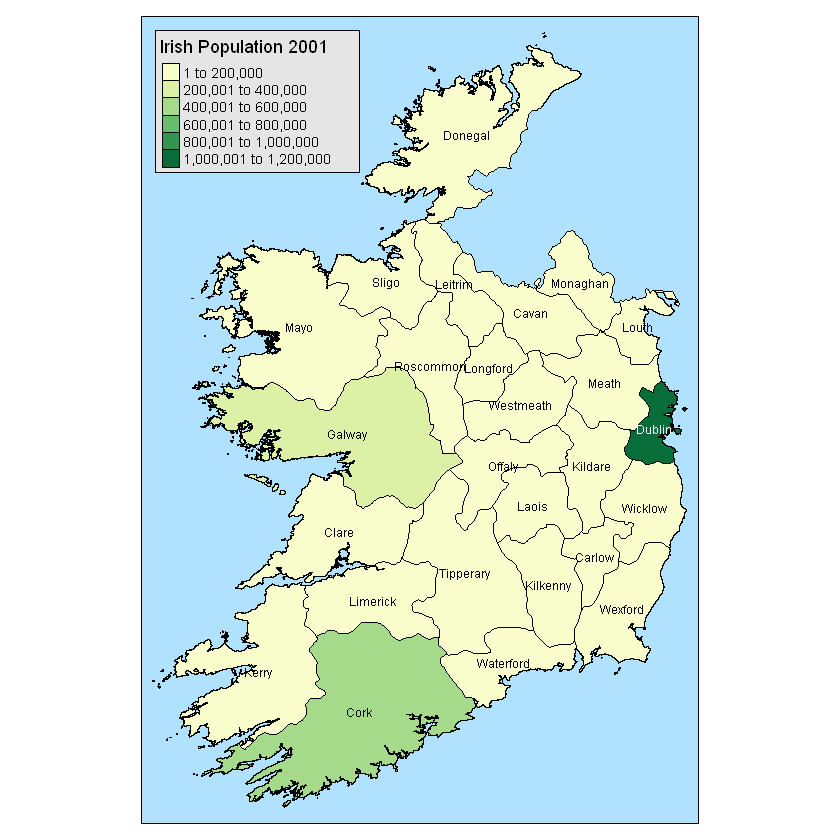

In [17]:
IRmap1 <- tm_shape(IRmap) +
    tm_fill("pop2001", title = "Irish Population 2001", palette = "YlGn") +
    tm_borders(alpha = 1) +
    tm_text("County", size = 0.6) +
    tm_style("natural")
IRmap1
tmap_save(IRmap1, filename="IRmap1.jpg")

In [18]:
# getting min and max values of all years used

minpop1841 = min(IRmap$pop1841)
maxpop1841 = max(IRmap$pop1841)

minpop1936 = min(IRmap$pop1936)
maxpop1936 = max(IRmap$pop1936)

minpop2001 = min(IRmap$pop2001)
maxpop2001 = max(IRmap$pop2001)

In [19]:
Palette1841 <- colorQuantile(palette="Reds", domain=c(minpop1841, maxpop1841))

Palette1936 <- colorQuantile(palette="Oranges", domain=c(minpop1936, maxpop1936))

Palette2001 <- colorQuantile(palette="Greens", domain=c(minpop2001, maxpop2001))

In [20]:
IR1841popup <- paste0("<b>County: ",
                     IRmap$County,
                     "</b><br />Population ",
                     IRmap$pop1841)

IR1936popup <- paste0("<b>County: ",
                     IRmap$County,
                     "</b><br />Population ",
                     IRmap$pop1936)

IR2001popup <- paste0("<b>County: ",
                     IRmap$County,
                     "</b><br />Population ",
                     IRmap$pop2001)

In [21]:
IRmap2 <- leaflet(IRmap) %>%
  addProviderTiles("CartoDB.Positron") %>%
  addPolygons(stroke=FALSE, 
              smoothFactor = 0.2, 
              fillOpacity = .8, 
              popup=IR1841popup, 
              color= ~Palette1841(IRmap$pop1841)
              )
IRmap2

HTML widgets cannot be represented in plain text (need html)

In [22]:
# re-project
IRmapsf<-st_as_sf(IRmap)
IRmap_projected <- sf::st_transform(IRmapsf, "+proj=longlat +datum=WGS84")
leaflet(IRmap_projected) %>%
  addProviderTiles("CartoDB.Positron") %>%
  addPolygons(stroke=FALSE, 
              smoothFactor = 0.2, 
              fillOpacity = .8, 
              popup=IR2001popup, 
              color= ~Palette2001(IRmap$pop2001)
  )

HTML widgets cannot be represented in plain text (need html)

In [23]:
library(tidyverse)
IRmap2 <- leaflet(IRmap) %>%
  addProviderTiles("CartoDB.Positron") %>%
  addPolygons(stroke=TRUE,
              weight=1,
              smoothFactor = 0.2, 
              fillOpacity = .75, 
              popup=IR1841popup, 
              color= ~Palette1841(IRmap$pop1841)
  ) %>% 
  
  
  addPolygons(stroke=TRUE,
              weight=1,
              smoothFactor = 0.2, 
              fillOpacity = .75, 
              popup=IR1936popup, 
              color= ~Palette1936(IRmap$pop1936)
  ) %>% 
  
  addPolygons(stroke=TRUE,
              weight=1,
              smoothFactor = 0.2, 
              fillOpacity = .75, 
              popup=IR2001popup, 
              color= ~Palette2001(IRmap$pop2001)
  ) %>% 
    addLegend(position="bottomleft", colors=c("#984ea3"),
            labels=c("Population"))   %>%
  
  
  addLayersControl(
    baseGroups=c("1841", "1936", "2001"),
    position = "bottomleft",
    options = layersControlOptions(collapsed = FALSE)
  ) 
IRmap2

── Attaching packages ─────────────────────────────────────────────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.0     ✔ purrr   1.0.1
✔ tibble  3.1.8     ✔ stringr 1.5.0
✔ tidyr   1.3.0     ✔ forcats 1.0.0
✔ readr   2.1.3     
── Conflicts ────────────────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ readr::col_factor() masks scales::col_factor()
✖ purrr::discard()    masks scales::discard()
✖ tidyr::extract()    masks raster::extract()
✖ dplyr::filter()     masks stats::filter()
✖ dplyr::lag()        masks stats::lag()
✖ dplyr::select()     masks raster::select()


HTML widgets cannot be represented in plain text (need html)